# Yolo keras from scratch

In [ ]:
from __future__ import print_function
import numpy as np
np.random.seed(123)
from keras.layers import Input, Dense, Activation, ZeroPadding2D, BatchNormalization, Conv2D,Dense, Dropout, Flatten, Reshape
from keras.layers import AveragePooling2D, MaxPooling2D, Dropout, GlobalMaxPooling2D, GlobalAveragePooling2D
from keras.layers.advanced_activations import LeakyReLU
from keras.models import load_model, Model
from keras.preprocessing.image import ImageDataGenerator
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math
#from google.colab import drive
#from google.colab.patches import cv2_imshow
import glob
import keras
import tensorflow as tf
from keras import backend as K
from keras.models import load_model
import sys
import cv2
import argparse

### Import modules

In [2]:
plt.rcParams['figure.figsize'] = (12, 12)

### The labels are stored as center_x,center_y, width , height of bbox of the object

In [5]:
def bboxer(image_path,text_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    with open(text_path) as f:
        data = f.readlines()
    for i in data:
        classes,x,y,w,h = i.split(' ')
        x_ = eval(x)*image.shape[1]
        y_ = eval(y)*image.shape[0]
        w_ = eval(w)*image.shape[1]
        h_ = eval(h)*image.shape[0]
        image = cv2.rectangle(image,(int(x_)-int(w_/2),int(y_)-int(h_/2)),(int(x_)+int(w_/2),int(y_)+int(h_/2)),(255,0,0),3)
    #return image
    plt.imshow(image)

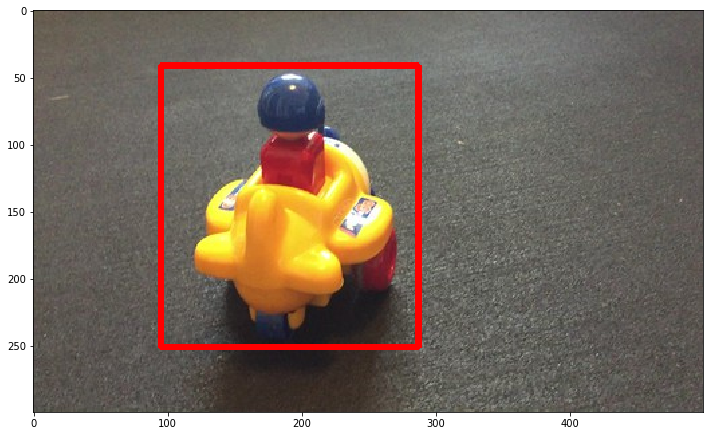

In [8]:
bboxer('images/10.jpg','bbox_txt/10.txt')

### Representation fn helps in visualizing the 12 x12 grid layover image and centroid of the bbox

In [9]:
def representation(image_path,data_path):
    image = cv2.imread(image_path)
    #image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image,(384,384))
    for i in range(0,385,32):
    #print(i)
        image = cv2.line(image,(i,0),(i,384),(0,255,0),2)
        image = cv2.line(image,(0,i),(385,i),(0,255,0),2)
    with open(data_path) as f:
        data = f.readlines()
    for i in data:
        classes,x,y,w,h = i.split(' ')
        x_ = int(eval(x)*image.shape[1])
        y_ = int(eval(y)*image.shape[0])
        image = cv2.circle(image,(x_,y_),3,(255,0,0),-1)
    plt.imshow(image)

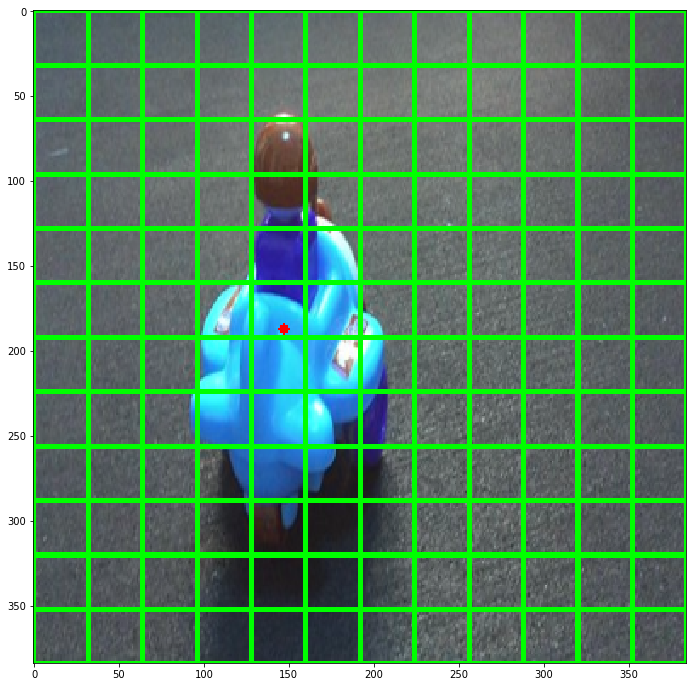

In [10]:
representation('images/10.jpg','bbox_txt/10.txt')

### Create dataset by reading images and corresponding labels

In [11]:
def get_labels(data):
    label_info = np.zeros(shape=(12, 12, 2, 5), dtype=np.float32)
    for i in data:
        classes,x,y,w,h = i.split(' ')
        x_ = eval(x)*384/32
        y_ = eval(y)*384/32
        w_ = eval(w)
        h_ = eval(h)
    #print(x_,y_)
        frac_x, whole_x = math.modf(x_)
        frac_y, whole_y = math.modf(y_)
        if(label_info[int(whole_x),int(whole_y),0][4] != 1.0):
            label_info[int(whole_x),int(whole_y),0] =  np.array([frac_x,frac_y,w_,h_,1.0])
        elif(label_info[int(whole_x),int(whole_y),1][4] != 1.0):
            label_info[int(whole_x),int(whole_y),1] =  np.array([frac_x,frac_y,w_,h_,1.0])
        else:
            print('filled')
    return label_info

In [12]:
def train_data(image_path,data_path):
    image = cv2.imread(image_path)
    with open(data_path) as f:
        data = f.readlines()
        labels = get_labels(data)
    return cv2.resize(image,(384,384)),labels

In [13]:
image,label = train_data('images/10.jpg','bbox_txt/10.txt')

In [17]:
all_images = glob.glob('images/*.jpg')
all_text = glob.glob('bbox_txt/*.txt')
x_train = []
y_train = []
for i,j in zip(all_images,all_text):
    image,label = train_data(i,j)
    x_train.append(image)
    y_train.append(label)
    
print(np.array(x_train).shape,np.array(y_train).shape)

(90, 384, 384, 3) (90, 12, 12, 2, 5)


### make a tiny yolo model using keras , default input shape is 384,384 and nb_boxes are the no. of bbox each grid cell in the image will make i.e 2, grid_w and grid_h represents the no. of cells the image will be divided into

In [3]:
def TinyYoloModel(input_shape=(384,384,3),nb_boxes = 2,grid_w = 12,grid_h = 12):
    """
    Implementation of the Tiny YOLOv2 Model in Keras.

    Arguments:
    input_shape -- shape of the images of the dataset

    Returns:
    model -- a Model() instance in Keras
    """

    # Define the input placeholder as a tensor with shape input_shape. Think of this as your input image!
    X_input = Input(shape=input_shape)

    #https://github.com/xslittlegrass/CarND-Vehicle-Detection/blob/master/vehicle%20detection.ipynb
    # Layer 1-8
    for i in range(1,9):
        if i==1:
            X = X_input

        # 2D Convolution
        if i != 8:
            X = Conv2D(2**(3+i), kernel_size=(3,3), strides=(1,1), padding='same', name='conv2d_'+str(i), use_bias=False)(X)
        elif i == 8:
            X = Conv2D(512, kernel_size=(3,3), strides=(1,1), padding='same', name='conv2d_'+str(i), use_bias=False)(X)

        # Batch Normalization
        X = BatchNormalization(name='batch_normalization_'+str(i))(X)

        # Leaky ReLU
        X = LeakyReLU(alpha=0.1, name='leaky_re_lu_'+str(i))(X)

        # MaxPooling2D
        if i <= 5:
            X = MaxPooling2D(pool_size=(2,2), name='max_pooling_2d_'+str(i))(X)
        if i == 6:
            X = MaxPooling2D(pool_size=(1,1), name='max_pooling_2d_'+str(i))(X)

    # Layer 9
    '''
    Parameters:
    bbox_count -- number of bounding boxes you want each YOLO grid to output per grid cell (e.g. 5 in YOLOv2)
    bbox_info -- Confidence score for a bbox, and bbox dimension's x-position, y-position, width, and height (i.e. fixed at 5)
    classes -- number of classes you want to predict (e.g. building, tree, road, etc)
    
    So if predicting on:
    1 bounding box per grid, 1 class, filters = 1*(5+1) = 6
    5 bounding boxes per grid, 20 classes, filters = 5*(5+20) = 125 (e.g. PASCAL VOC )
    filters = (no. of bounding boxes you want model to predict) * (no. of classes + 5) 
    '''
    bbox_info = 5  #fixed at 5!!
    bbox_count, classes = (1, 1)
    last_filters = bbox_count * (bbox_info + classes)
    X = Conv2D(filters=last_filters, kernel_size=(1,1), strides=(1,1), padding='same', name='conv2d_9', use_bias=False)(X)

    # FLATTEN X (means convert it to a vector) + FULLYCONNECTED
    X = Flatten()(X)
    X = Dense(256, activation='sigmoid')(X)
    X = Dense(grid_w*grid_h*(nb_boxes*5), activation='sigmoid')(X)
    X = Reshape((grid_w,grid_h,nb_boxes,5))(X)

    # Create model. This creates your Keras model instance, you'll use this instance to train/test the model.
    model = Model(inputs = X_input, outputs = X, name='TinyYoloModel')

    return model


### making a custom loss fn , which will sums the offsets in xy coordinates and wh and iou loss.

In [4]:
def custom_loss_2(y_true,y_pred):
    #y_true,y_pred = y_train[0],y_train[1]
    pred_boxes = K.reshape(y_pred, (-1,grid_w*grid_h,nb_boxes,5))
    #print(pred_boxes)
    true_boxes = K.reshape(y_true, (-1,grid_w*grid_h,nb_boxes,5))
    #print(true_boxes)
    #pred_boxes = y_pred
    y_pred_xy   = pred_boxes[...,0:2]
    y_pred_wh   = pred_boxes[...,2:4]
    y_pred_conf = pred_boxes[...,4]

    y_true_xy   = true_boxes[...,0:2]
    y_true_wh   = true_boxes[...,2:4]
    y_true_conf = true_boxes[...,4]
    
    xy_loss    = K.sum(K.sum(K.square(y_true_xy - y_pred_xy),axis=-1)*y_true_conf, axis=-1)
    wh_loss    = K.sum(K.sum(K.square(K.sqrt(y_true_wh) - K.sqrt(y_pred_wh)), axis=-1)*y_true_conf, axis=-1)
    intersect_wh = K.maximum(K.zeros_like(y_pred_wh), (y_pred_wh + y_true_wh)/2 - K.abs(y_pred_xy - y_true_xy) )
    intersect_area = intersect_wh[...,0] * intersect_wh[...,1]
    true_area = y_true_wh[...,0] * y_true_wh[...,1]
    pred_area = y_pred_wh[...,0] * y_pred_wh[...,1]
    union_area = pred_area + true_area - intersect_area
    iou = intersect_area / union_area

    conf_loss = K.sum(K.square(y_true_conf*iou - y_pred_conf)*y_true_conf, axis=-1)

    d =  xy_loss + wh_loss + conf_loss
    #d = K.mean(d)

    #d = tf.Print(d, [d], "Inside loss function")
    return K.sum(d)

In [20]:
X_train = np.array(x_train)/255

In [24]:
nb_boxes = 2
grid_w = 12
grid_h = 12

In [25]:
model  = TinyYoloModel()

In [26]:
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, decay=0.0)
model.compile(loss=custom_loss_2, optimizer=adam) # better
print(model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 384, 384, 3)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 384, 384, 16)      432       
_________________________________________________________________
batch_normalization_1 (Batch (None, 384, 384, 16)      64        
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 384, 384, 16)      0         
_________________________________________________________________
max_pooling_2d_1 (MaxPooling (None, 192, 192, 16)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 192, 192, 32)      4608      
_________________________________________________________________
batch_normalization_2 (Batch (None, 192, 192, 32)      128       
__________

In [ ]:
from keras.callbacks import ModelCheckpoint
checkpoint = ModelCheckpoint('toy_model_tiny.hdf5', monitor='loss', verbose=1, save_best_only=True, mode='min')

In [ ]:
model.fit(X_train,y_train, batch_size=45,callbacks = [checkpoint], epochs=1000)

In [0]:
from keras.models import load_model
model = load_model('toy_model_tiny.hdf5', custom_objects={'custom_loss_2': custom_loss_2})

### make_bbox takes the best confidence bbox and plots it on the image

In [ ]:
def make_bbox(coordinates):
  all_boxes = []
  arr = np.where(coordinates[...,4])
  arr = np.array(arr)
  for i in range(len(arr[0])):
    sec_arr=arr[...,i]
    #print(sec_arr[:])
    main_arr = coordinates[sec_arr[0]][sec_arr[1]][sec_arr[2]][sec_arr[3]]
    #print(main_arr)
    main_arr = main_arr + [sec_arr[1],sec_arr[2],0,0,0]
    #print(main_arr)    
    all_boxes.append([main_arr[0]*32,main_arr[1]*32,main_arr[2]*384,main_arr[3]*384,main_arr[4]])
  all_boxes = np.array(all_boxes).reshape(1,288,5)
  a = all_boxes[0]
  final = a[a[:,4].argsort()]
  
  return final[-1]

[146.89430237 187.65726852 148.17947388 270.16234589   0.95812249]


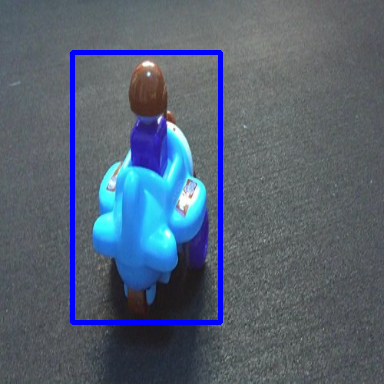

[118.08420944 207.18083572 210.21343231 243.13957214   0.96219724]


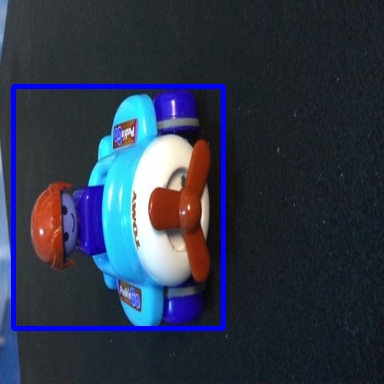

[183.41134834 155.6517067  162.87400818 277.92391205   0.96954536]


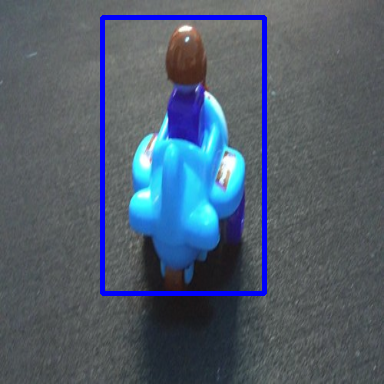

[182.0711174  156.6036377  119.15901947 191.0865097    0.9565711 ]


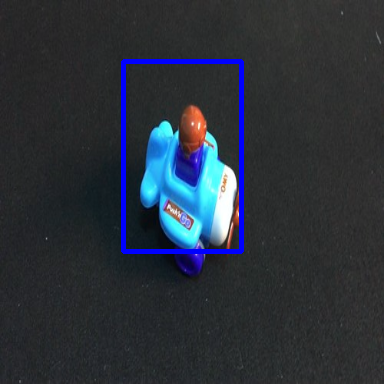

[106.00654602 256.45987034 198.73764038 243.8371582    0.95242316]


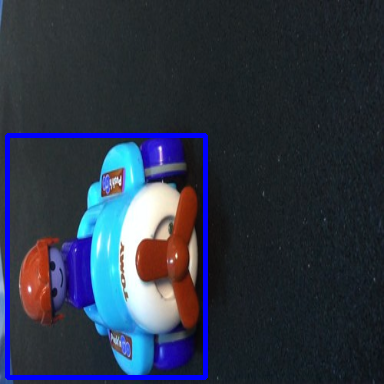

[107.6710453  214.47776031 193.53515625 230.46739197   0.94815469]


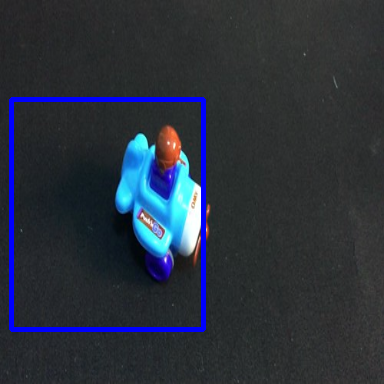

[175.71393108 154.39889717 156.48163605 198.72546387   0.96123713]


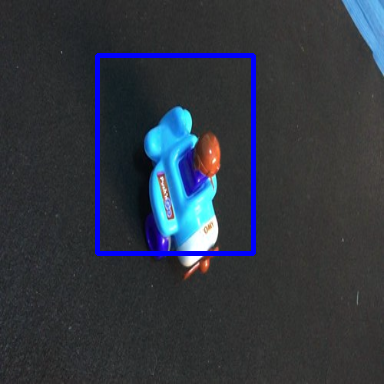

[102.68482399 199.5496521  203.50721741 261.11009216   0.97061241]


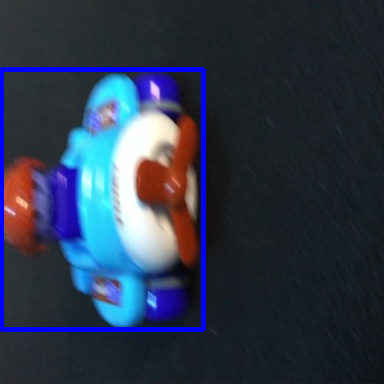

[130.71677971 178.69223404 195.03941345 234.2299118    0.96545959]


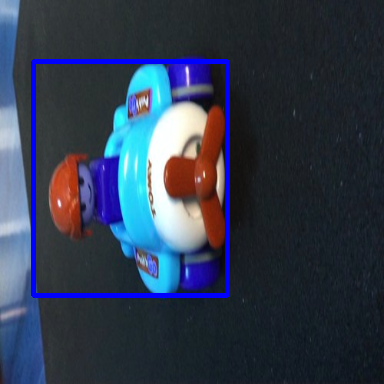

[177.72464561 155.47520828 155.1168251  203.86100006   0.93001431]


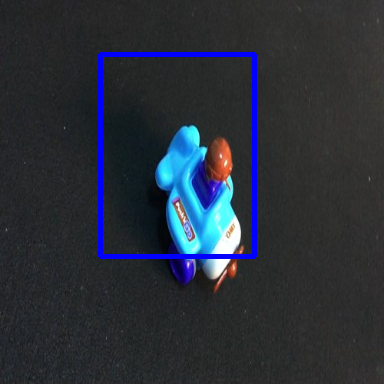

[ 99.71896076 237.51519775 146.66841888 272.32170868   0.91981936]


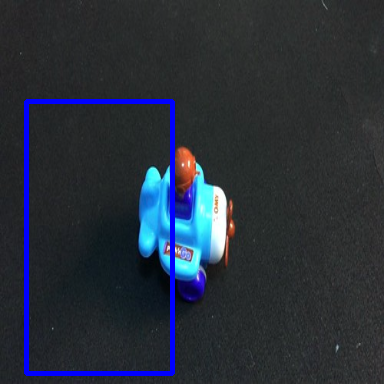

[180.82701111 156.34174728 127.18225479 195.95677185   0.94567168]


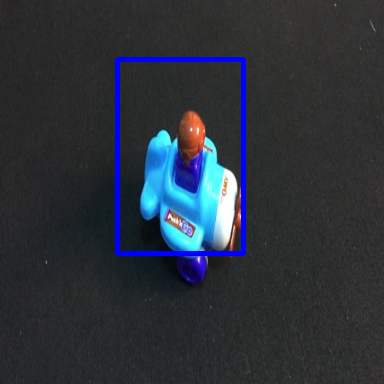

[148.65988731 197.01361465 206.98006439 213.61434174   0.94845033]


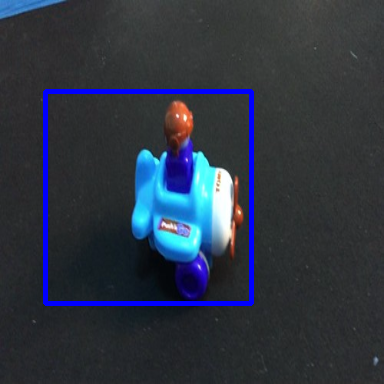

[ 99.66260815 239.37942028 179.64677811 277.60070801   0.95378172]


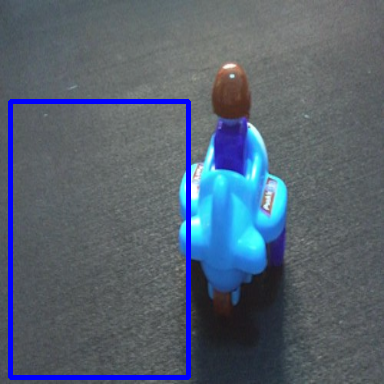

[288.94351864 199.83344173 129.74107361 253.42980194   0.95360613]


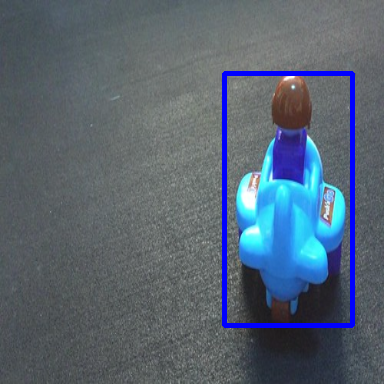

[152.21063232 197.94235897 173.7973938  226.79351807   0.97056746]


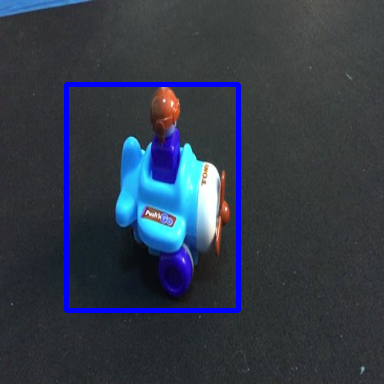

[176.48526955 156.72763824 143.47468185 194.71652985   0.9340502 ]


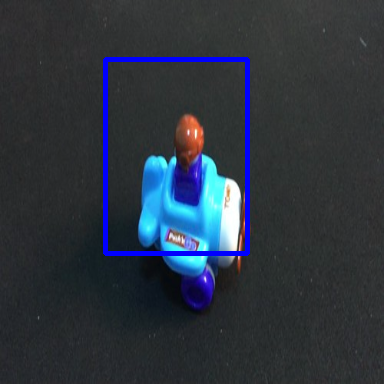

[176.58017921 156.51125145 141.29865646 187.16439056   0.94308197]


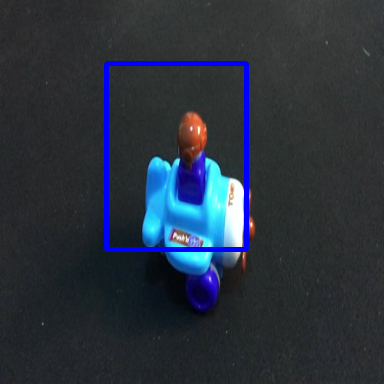

[114.64697456 227.73720551 205.14367676 236.11610413   0.96590245]


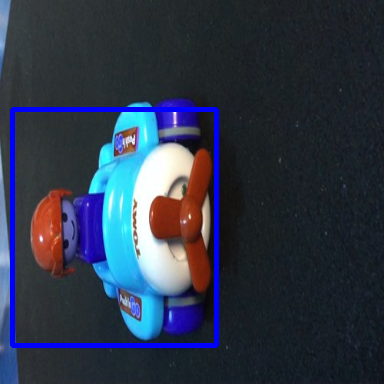

[224.86146355 147.68679047 188.40716171 221.28531647   0.96563411]


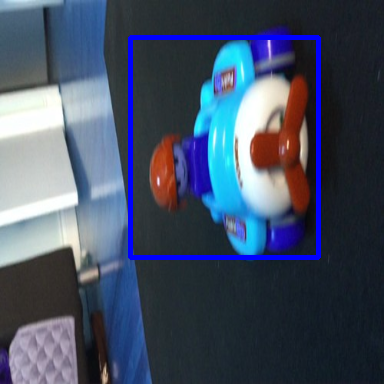

[149.5959816  197.12376022 145.2612648  246.80085754   0.94867933]


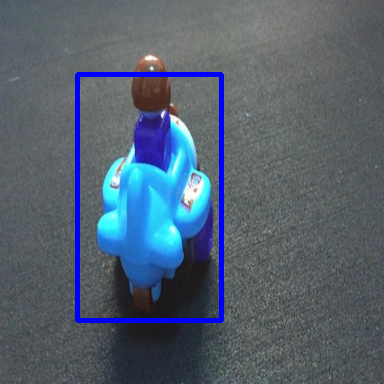

[217.46346092 142.77242279 134.76411438 270.44865417   0.94329107]


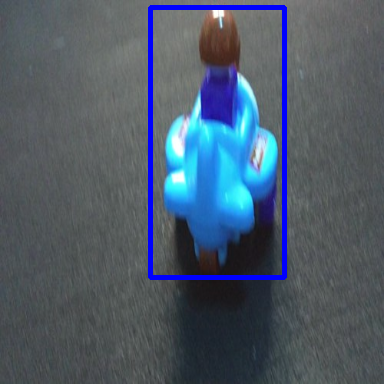

[145.74482918 196.64158916 215.25199127 213.72683716   0.96383011]


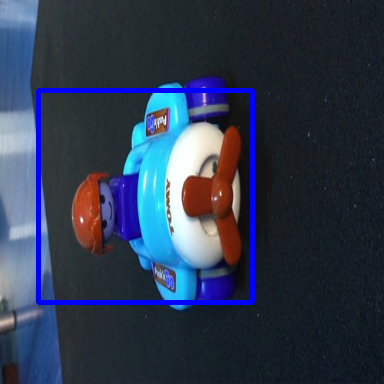

[138.09126186 199.75949764 164.38508606 248.05233765   0.95357907]


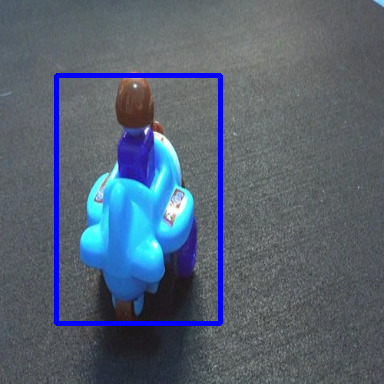

[140.59836292 189.03531647 148.57498169 240.86304474   0.96982646]


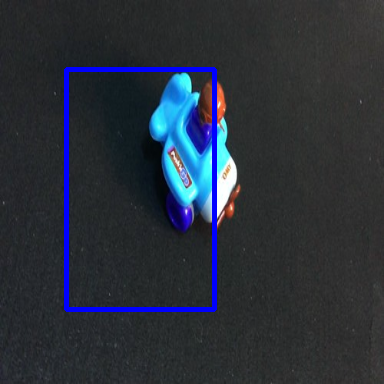

[136.28347111 180.97795677 144.60886002 185.74120331   0.95460153]


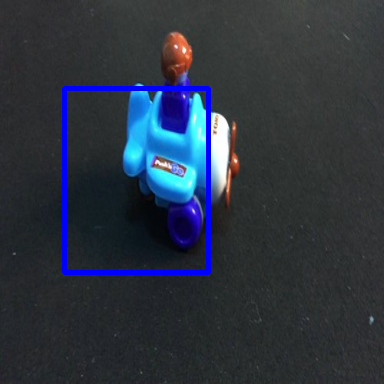

[111.14273453 207.24567604 206.41280365 248.2747879    0.96820897]


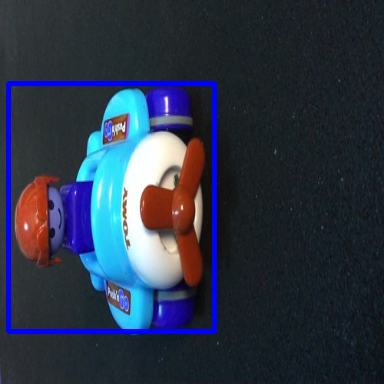

[155.67958832 182.6028862  152.09264374 254.87866974   0.9463253 ]


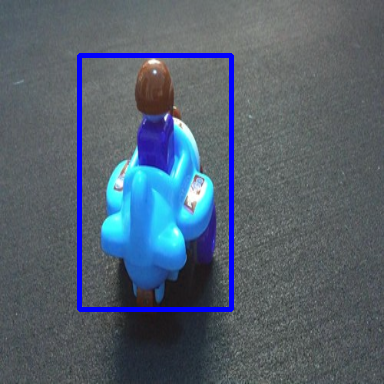

[179.3646965  155.38351822 142.34925842 184.6006279    0.94401783]


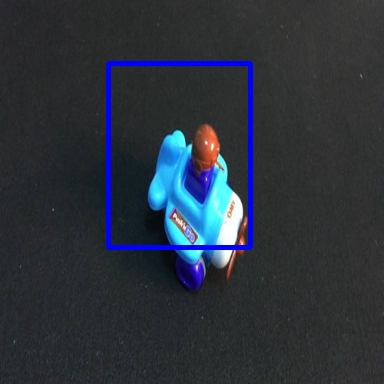

[151.24384689 184.91565132 161.66104889 219.10890198   0.93393308]


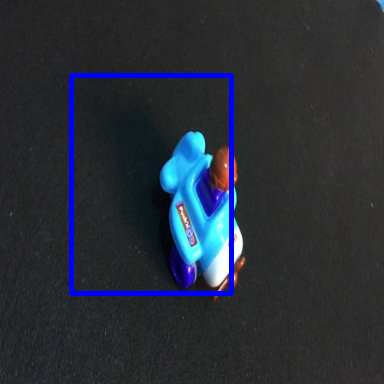

[174.48619652 196.31978321 205.28173828 216.40333557   0.96179247]


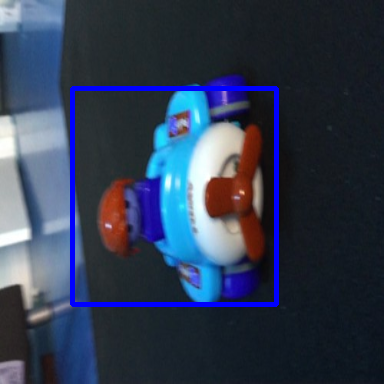

[178.49922562 156.36121368 140.33686066 181.30396271   0.94212991]


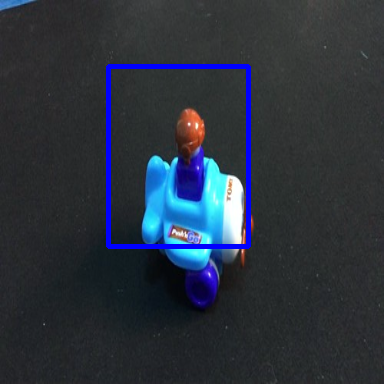

[157.26423645 195.32934761 113.83424377 167.1800766    0.94890147]


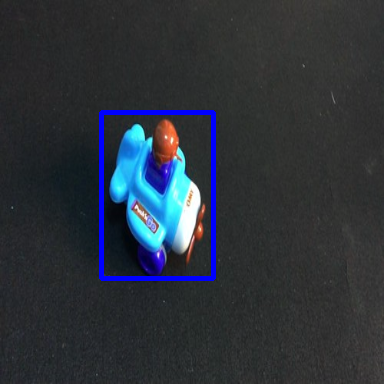

[178.45827675 154.27075958 162.00718689 185.58102036   0.95267224]


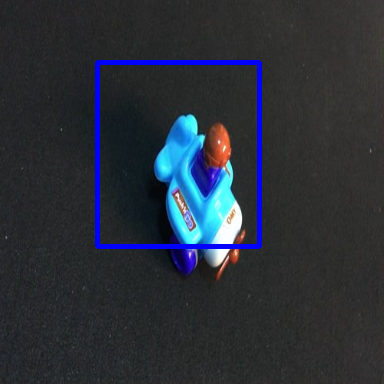

[113.14964485 229.10148716 196.53632355 254.4131012    0.96728575]


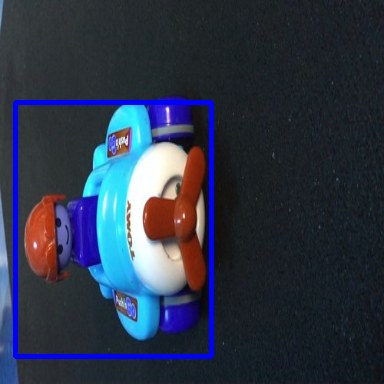

[150.03892517 197.24988079 191.45117569 161.20877838   0.95881444]


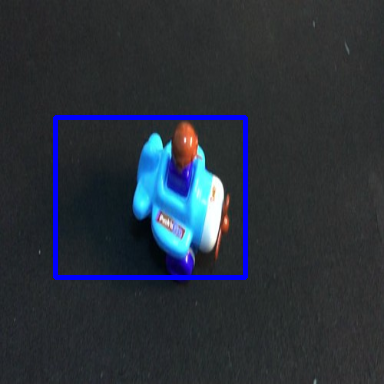

[175.54969692 155.4618206  156.11058426 221.08266449   0.94718206]


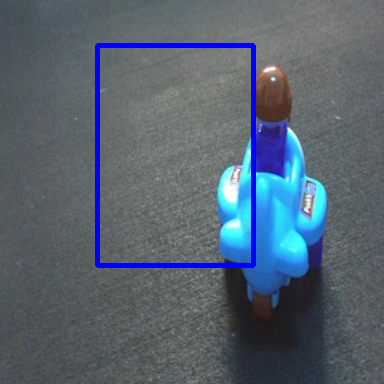

[136.47279739 205.60112381 155.44538498 260.13835144   0.95104074]


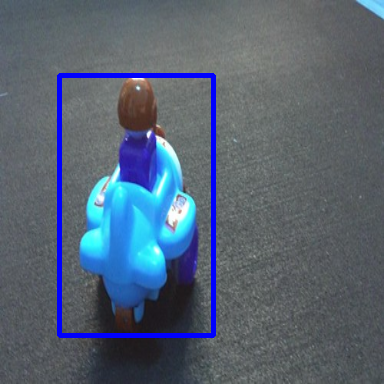

[140.28129959 187.16468048 136.45212936 287.06364441   0.93176556]


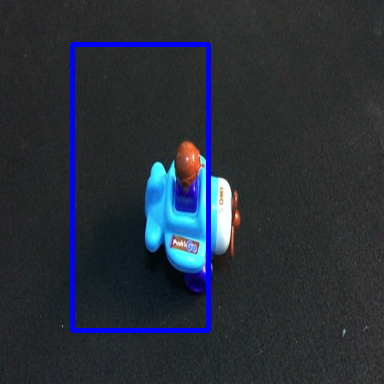

[109.94542789 207.16307354 227.12779999 225.20102692   0.93211102]


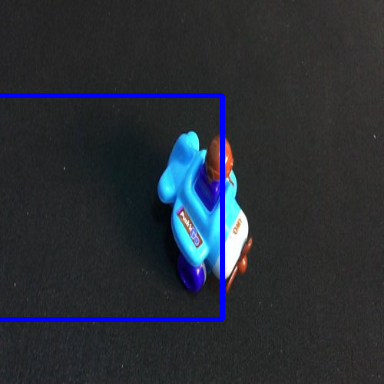

[178.43690491 154.2688446  162.19054413 185.49506378   0.95257032]


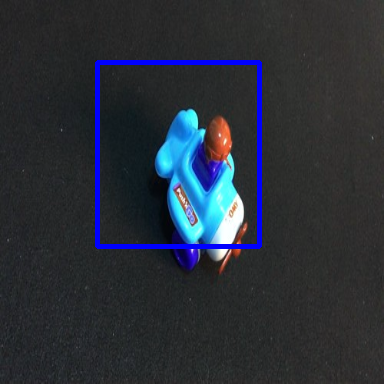

[149.23340607 198.35592842 203.56118774 229.2322998    0.96265876]


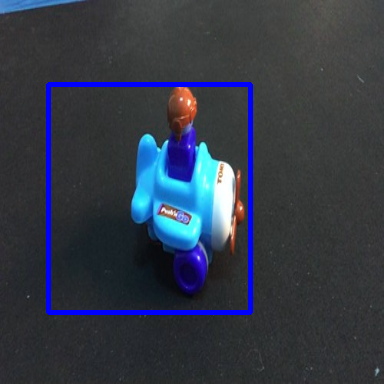

[106.5878458  259.62555122 197.83348846 245.73390198   0.95656079]


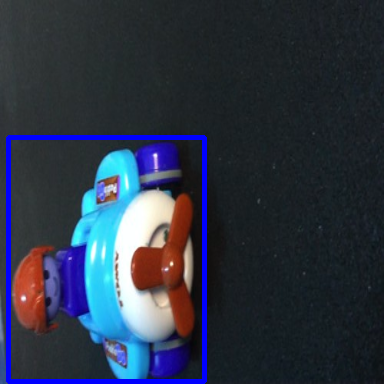

[179.07609558 156.09662247 136.16181564 199.15081787   0.9527036 ]


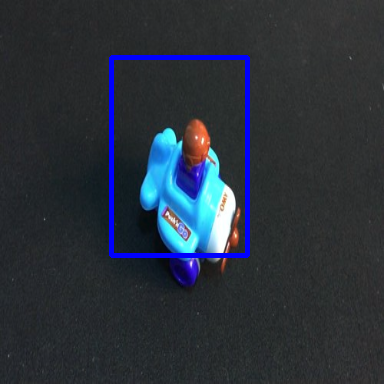

[143.73711014 196.27839565 144.56777573 216.70962524   0.9485693 ]


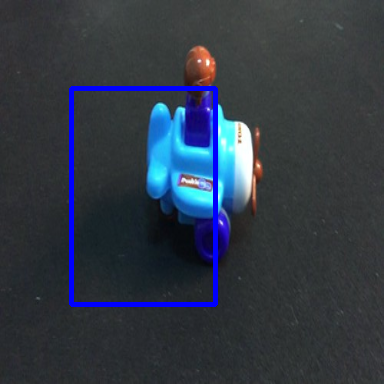

[140.61308384 188.64432526 132.3862381  190.74833679   0.96185488]


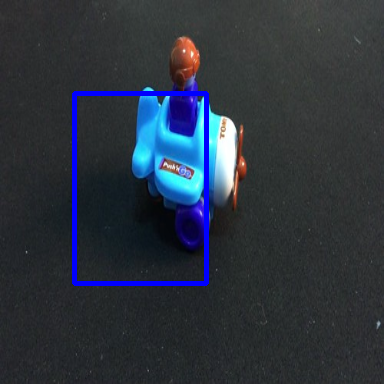

[110.07582283 229.31050777 193.84364319 261.36410522   0.96647453]


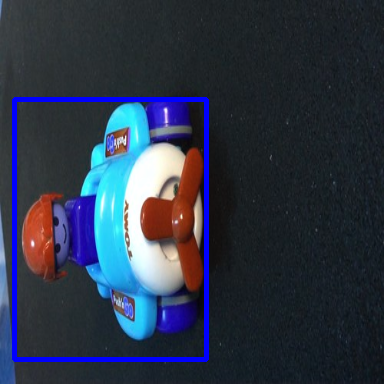

[ 97.80032349 238.30923843 171.16201401 259.44552612   0.94397897]


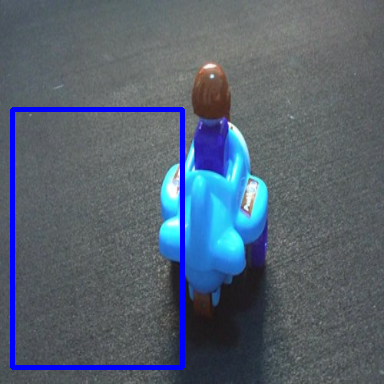

[179.81435013 157.26274109 179.91398621 223.4019928    0.96639341]


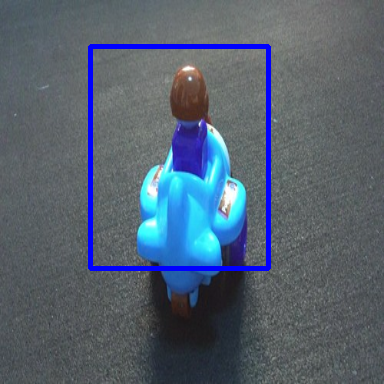

[148.81316757 199.01515865 207.80744934 215.69329834   0.95872021]


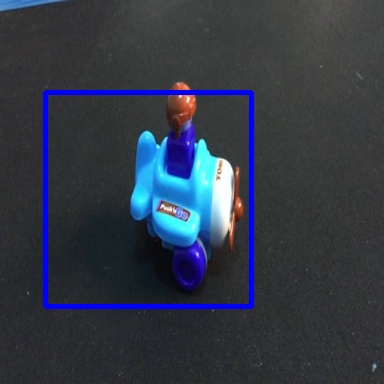

[146.95885658 169.08926582 136.63796997 261.13627625   0.94277167]


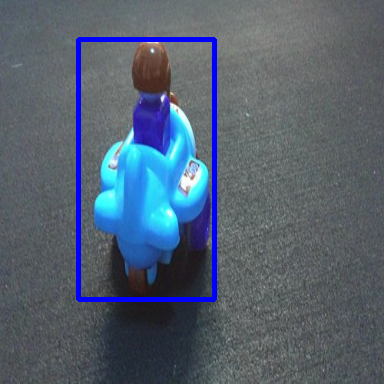

[ 98.84765816 227.72188282 191.00333405 304.69161987   0.97123349]


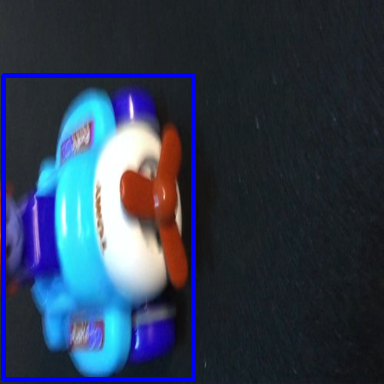

[147.16339874 187.61818695 144.99117279 268.36626434   0.95674706]


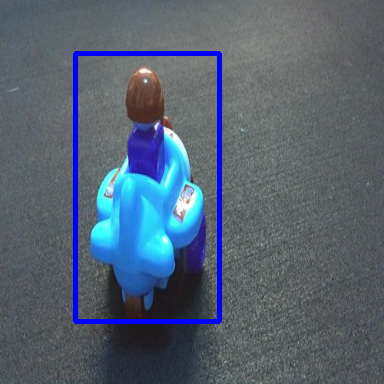

[102.82529163 235.35220528 157.84311676 262.48148346   0.90585339]


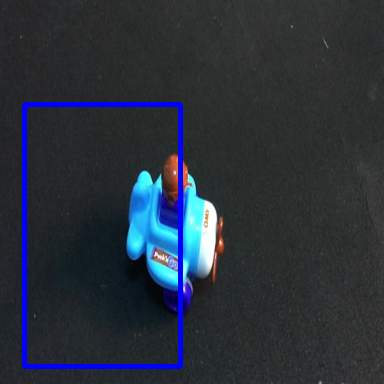

[166.53180885 142.91942596 129.07731628 234.2066803    0.955607  ]


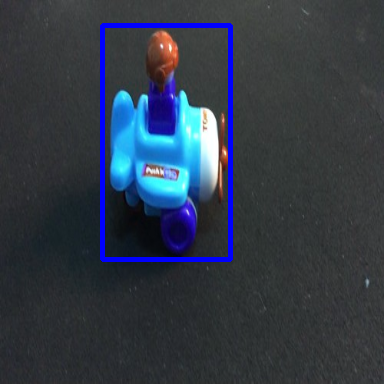

[108.93353462 193.4765625  207.39509583 255.96427917   0.96639216]


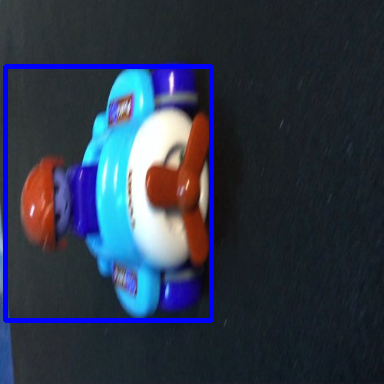

[121.83605003 135.62315845 207.90868378 253.87843323   0.96041769]


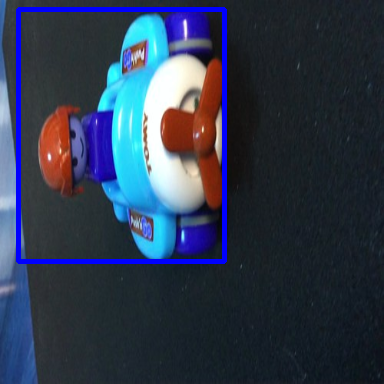

[147.01064301 195.36886883 172.40409851 200.98107147   0.95745099]


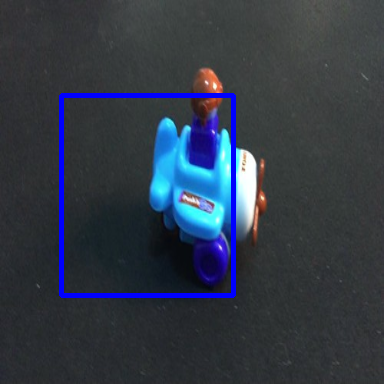

[167.65956497 139.50721645 131.36771393 232.85426331   0.94786978]


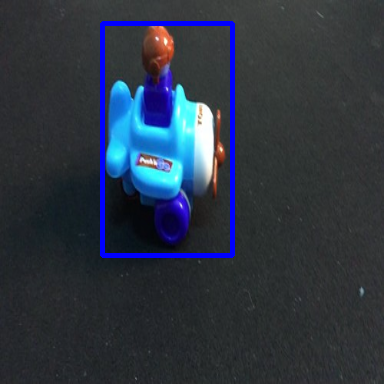

[183.66255379 156.11275673 144.8085022  156.11920166   0.96912336]


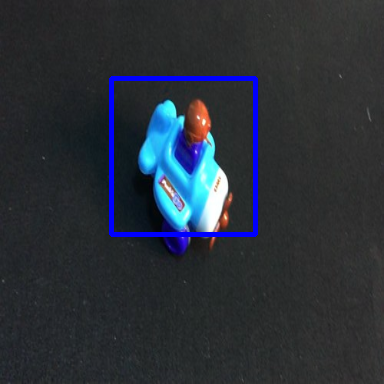

[101.18702793 234.90000057 134.17176819 262.32154083   0.92031169]


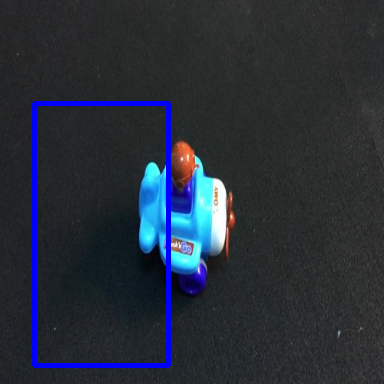

[150.32491112 199.79297924 136.22438049 253.48374939   0.95407218]


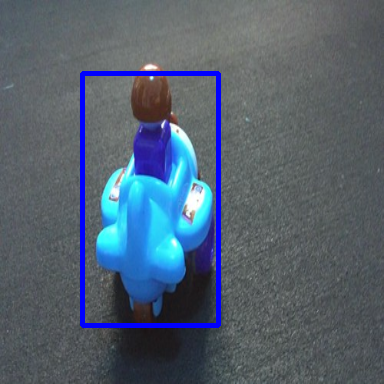

[117.72805977 243.34847641 197.5837326  227.78572083   0.96651411]


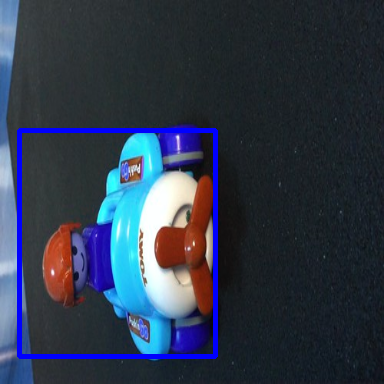

[129.36128235 194.64360619 144.52661133 256.03456879   0.93829834]


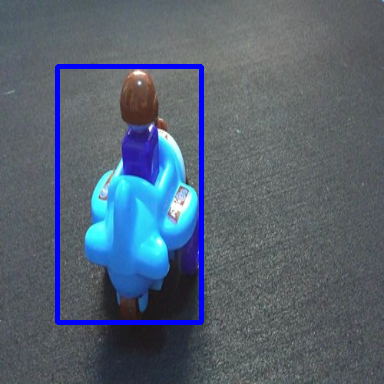

[176.53519058 154.83322144 158.58869934 198.54068756   0.94011319]


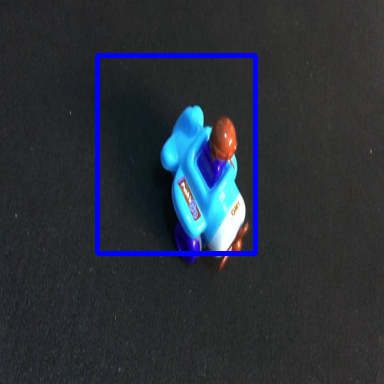

[107.3133297  258.33460522 197.24727631 245.53438568   0.94971895]


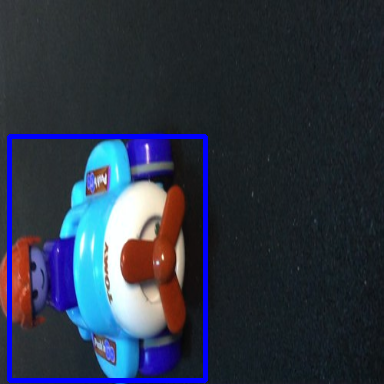

[152.8234024  184.99555016 163.79386139 235.4477005    0.93535113]


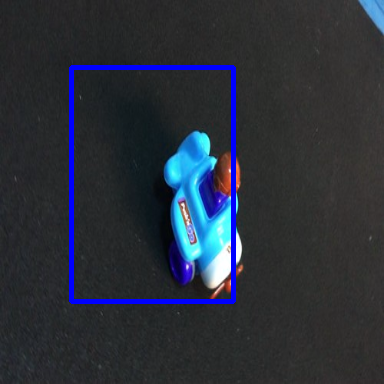

[177.61667824 158.64932632 165.75434875 231.73869324   0.96996397]


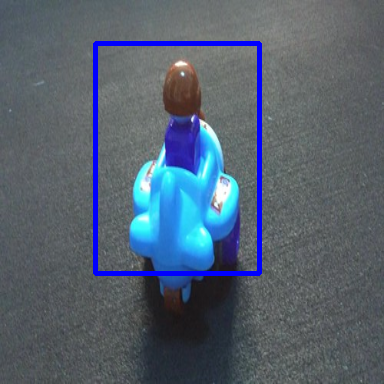

[100.7255621  229.54546547 211.24099731 284.71964264   0.96444851]


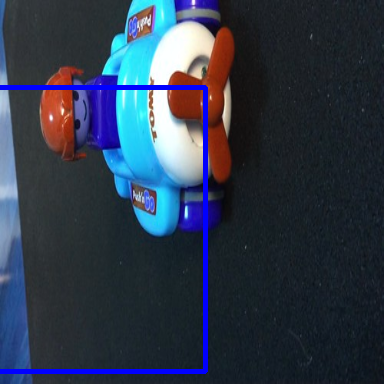

[171.82703972 189.29853058 138.97913361 258.97386932   0.95146906]


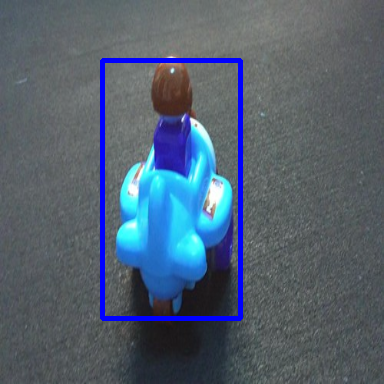

[112.12225151 229.81293011 191.0786705  243.61216736   0.96145302]


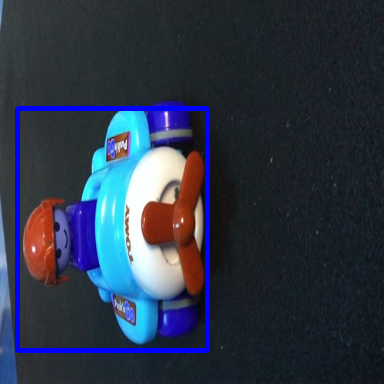

[118.45730591 252.63927078 192.93525696 221.52152252   0.95707309]


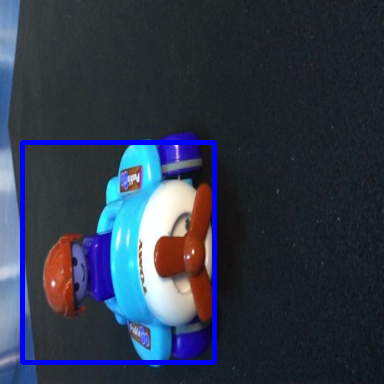

[156.61819458 187.337883   172.11465454 261.40921783   0.9521327 ]


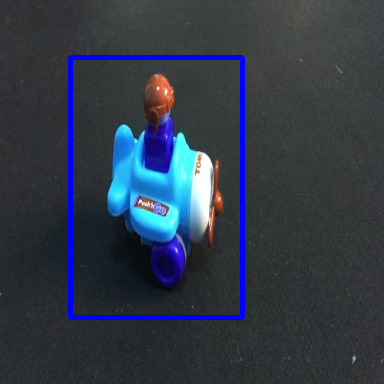

[145.15912819 196.77805996 210.94487    220.91816711   0.9602077 ]


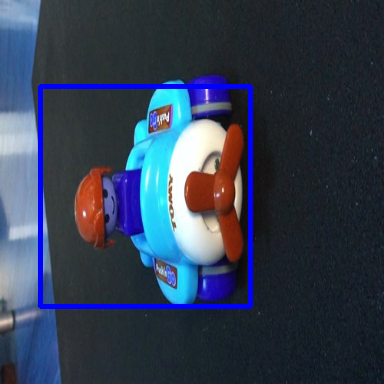

[177.04513931 154.92206573 157.66407394 195.70811462   0.92736328]


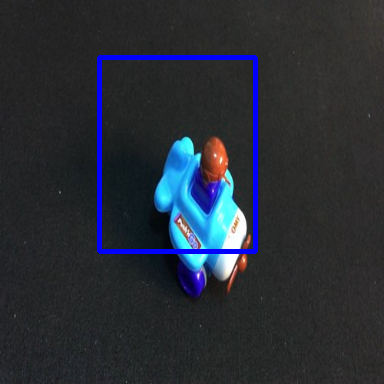

[104.2825489  234.91968727 175.84761429 256.19700623   0.93715197]


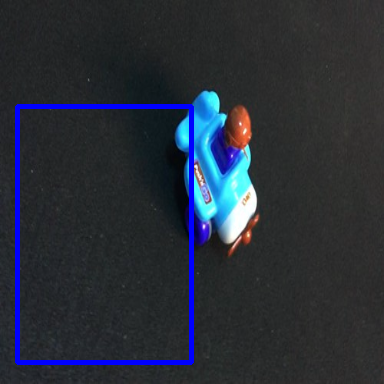

[151.5442009  185.26415253 177.04100418 208.50123596   0.94293547]


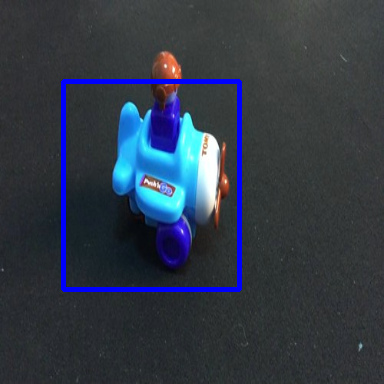

[116.50010109 227.04873753 200.57444    229.14232635   0.96418858]


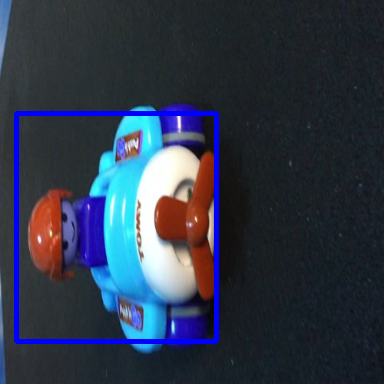

[182.26226425 154.44406891 145.08630753 226.62336731   0.95659071]


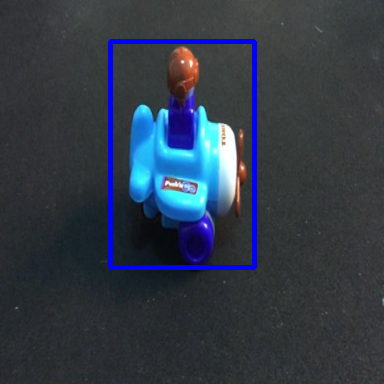

[179.08604813 156.86361885 179.12220383 230.53740692   0.94503331]


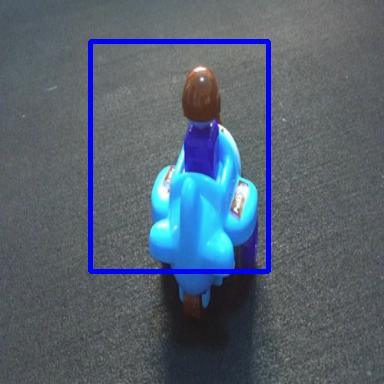

[166.04377079 143.35897732 139.03750992 225.17726898   0.95405066]


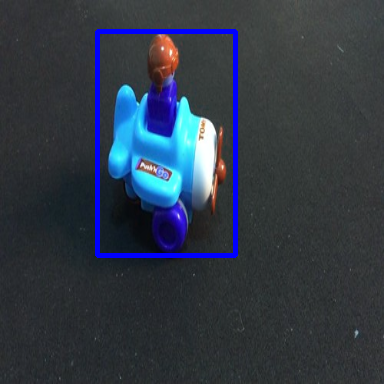

[149.36756897 197.32486534 178.1644249  225.91442871   0.96806347]


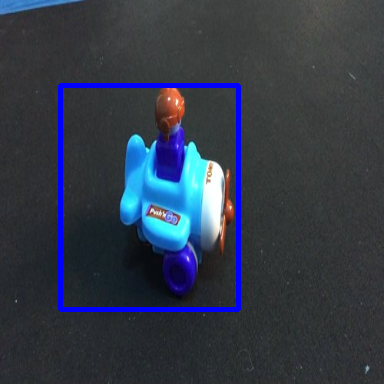

[152.43969345 196.79696369 167.41375351 240.95892334   0.96625936]


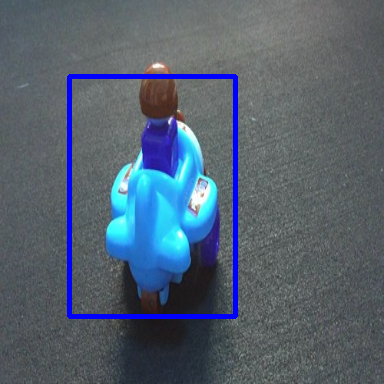

[140.85260963 202.8897438  192.99002838 276.52906036   0.9478184 ]


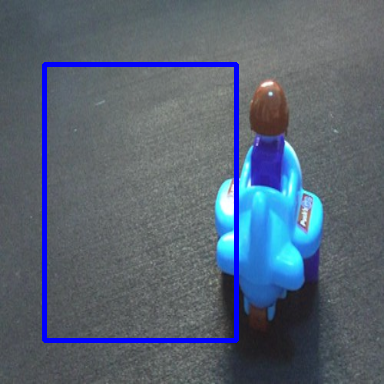

[184.6593399  156.75905991 118.79693985 167.6094017    0.9642508 ]


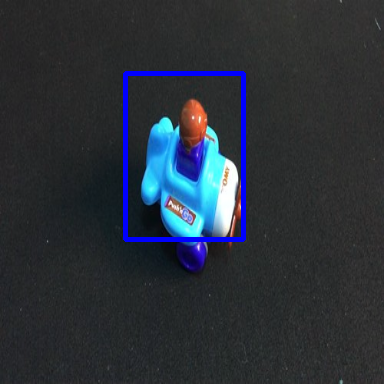

[148.06372833 197.69571686 191.96858597 234.8867569    0.96482176]


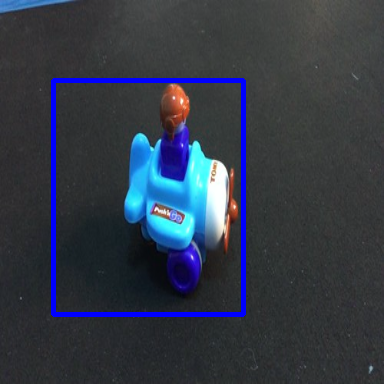

[169.62574768 133.99547863 126.01083755 223.87564087   0.9510026 ]


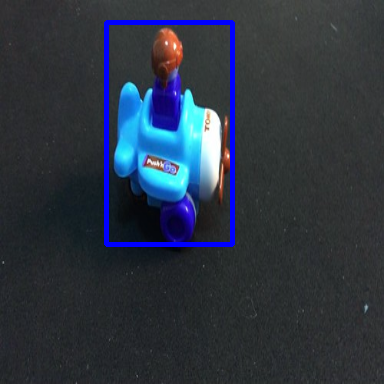

[165.33373451 137.83342075 125.95797729 223.96394348   0.94023359]


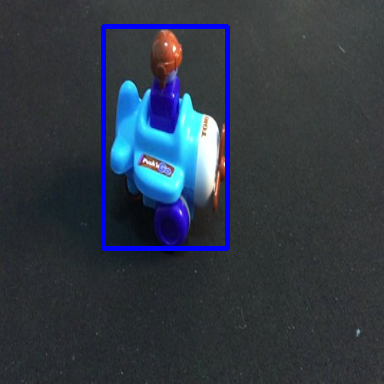

[166.42373085 145.82481766 141.44498062 223.1672287    0.94851482]


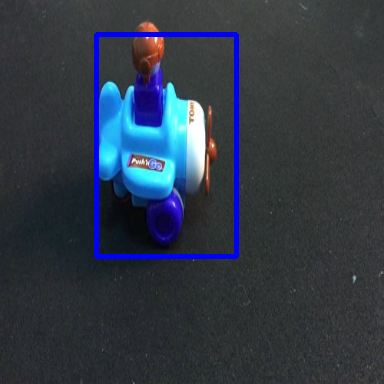

[129.34339333 201.46937752 143.53540421 265.20261383   0.93247831]


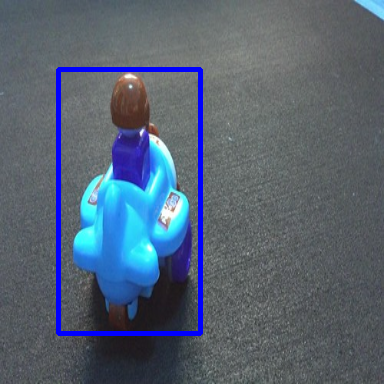

In [0]:
for j in x_train:
  ans = model.predict(np.expand_dims(j,0)/255)
  coor = make_bbox(ans)
  image = cv2.cvtColor(j, cv2.COLOR_BGR2RGB)
  i =coor
  print(i)
  x_ = i[0]
  y_ = i[1]
  w_ = i[2]
  h_ = i[3]
  image = cv2.rectangle(image,(int(x_)-int(w_/2),int(y_)-int(h_/2)),(int(x_)+int(w_/2),int(y_)+int(h_/2)),(255,0,0),3)

  cv2_imshow(image)

In [0]:
def predictor(path):
  image = cv2.imread(path)
  print(image.shape)
  image = cv2.resize(image,(384,384))
  ans = model.predict(np.expand_dims(image,0)/255)
  coor = make_bbox(ans)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  i =coor
  print(i)
  x_ = i[0]
  y_ = i[1]
  w_ = i[2]
  h_ = i[3]
  image = cv2.rectangle(image,(int(x_)-int(w_/2),int(y_)-int(h_/2)),(int(x_)+int(w_/2),int(y_)+int(h_/2)),(255,0,0),3)
  cv2_imshow(image)
  

(372, 425, 3)
[148.56853676 195.31346989 189.7153244  210.47904968   0.97080302]


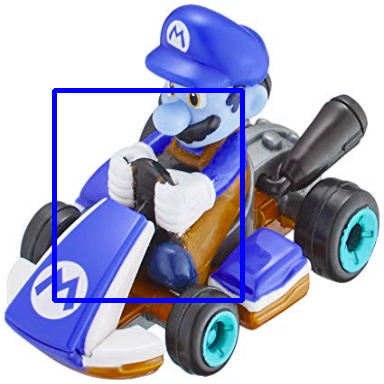

In [0]:
predictor('./test/71YMME9X1hL._SX425_.jpg')